<a href="https://colab.research.google.com/github/TejasMakadia/Amenity-Detection/blob/main/Detectron2_example.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Replicating Airbnb's Amenity Detection with Detectron2 👁 🛏

Some quick links which you might find helpful:
- [The original Airbnb amenity detection article](https://medium.com/airbnb-engineering/amenity-detection-and-beyond-new-frontiers-of-computer-vision-at-airbnb-144a4441b72e) (what this notebook replicates).
- [All of my project notes in Notion](https://dbourke.link/airbnb42days) (this started as a 42-day project to replicate the article above).
- [All the code I wrote to train the full model/run experiments on GitHub](https://github.com/mrdbourke/airbnb-amenity-detection).
- [All the modelling experiments I tracked in Weights & Biases](https://app.wandb.ai/mrdbourke/airbnb-amenity-detection).
- [The deployed app](https://github.com/mrdbourke/airbnb-amenity-detection) (finished product, beware, this might not be live if it's been a few months).
- [YouTube series documenting the process](https://www.youtube.com/playlist?list=PL6vjgQ2-qJFeMrZ0sBjmnUBZNX9xaqKuM).
- Original the [example Detectron2 Notebook](https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5).

First, let's get the dependencies we need. 

In [2]:
# Install Detectron2 dependencies: https://detectron2.readthedocs.io/tutorials/install.html (use cu100 because colab is on CUDA 10.0)
!pip install -U torch==1.4+cu100 torchvision==0.5+cu100 -f https://download.pytorch.org/whl/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'

!pip install awscli # you'll need this if you want to download images from Open Images (we'll see this later)

# Make sure we can import PyTorch (what Detectron2 is built with)
import torch, torchvision
torch.__version__
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 723.9MB 25kB/s 
     |████████████████████████████████| 4.0MB 31.2MB/s 
ERROR: torchtext 0.9.0 has requirement torch==1.8.0, but you'll have torch 1.4.0+cu100 which is incompatible.
  Found existing installation: torch 1.8.0+cu101
    Uninstalling torch-1.8.0+cu101:
      Successfully uninstalled torch-1.8.0+cu101
  Found existing installation: torchvision 0.9.0+cu101
    Uninstalling torchvision-0.9.0+cu101:
      Successfully uninstalled torchvision-0.9.0+cu101
     |████████████████████████████████| 276kB 10.8MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44074 sha256=bf2ccb113506467f2a989f7872f064dba507dffdc4e4a477e0a7d7a0520c5bb3
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
  

In [3]:
# install detectron2:
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu100/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu100/index.html
     |████████████████████████████████| 6.7MB 760kB/s 
     |████████████████████████████████| 51kB 4.8MB/s 
     |████████████████████████████████| 2.2MB 15.1MB/s 
     |████████████████████████████████| 133kB 39.9MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.3.post20210317-cp37-none-any.whl size=58543 sha256=035b91d67fbdf206d7e47d8355c27ba764690bb78b5a1ea1267257cc1cc3c7ef
  Stored in directory: /root/.cache/pip/wheels/d2/ee/3a/5c531df777c03d8c67f22c65f97d6f75321087482d05a9b218
  Created wheel for pycocotools: filename=pycocotools-2.0.2-cp37-cp37m-linux_x86_64.whl size=263988 sha256=246f14b51591ec2b8e310e5739f2b8dda37607e094d8f43be378125e53b334e5
  Stored in directory: /root/.cache/pip/wheels/68/a5/e7/56401832f23d0b2db351c5b682e466cb4841960b086da65e4e
  Created wheel for iopath: filename=iopath-0.1.6-cp37-none-any.whl size=18269 sha256=90692554bbce655effb16683beb4700d974c4a8d6d04b20122e6f7808b6

In [1]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger() # this logs Detectron2 information such as what the model is doing when it's training

# import some common libraries
import numpy as np
import pandas as pd
from tqdm import tqdm
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo # a series of pre-trained Detectron2 models: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md
from detectron2.engine import DefaultPredictor # a default predictor class to make predictions on an image using a trained model
from detectron2.config import get_cfg # a config of "cfg" in Detectron2 is a series of instructions for building a model
from detectron2.utils.visualizer import Visualizer # a class to help visualize Detectron2 predictions on an image
from detectron2.data import MetadataCatalog # stores information about the model such as what the training/test data is, what the class names are

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



--2021-03-21 12:26:35--  https://raw.githubusercontent.com/mrdbourke/airbnb-amenity-detection/master/custom_images/airbnb-article-cover.jpeg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2851732 (2.7M) [image/jpeg]
Saving to: ‘demo.jpeg’

demo.jpeg           100%[===================>]   2.72M  --.-KB/s    in 0.06s   

2021-03-21 12:26:36 (46.2 MB/s) - ‘demo.jpeg’ saved [2851732/2851732]



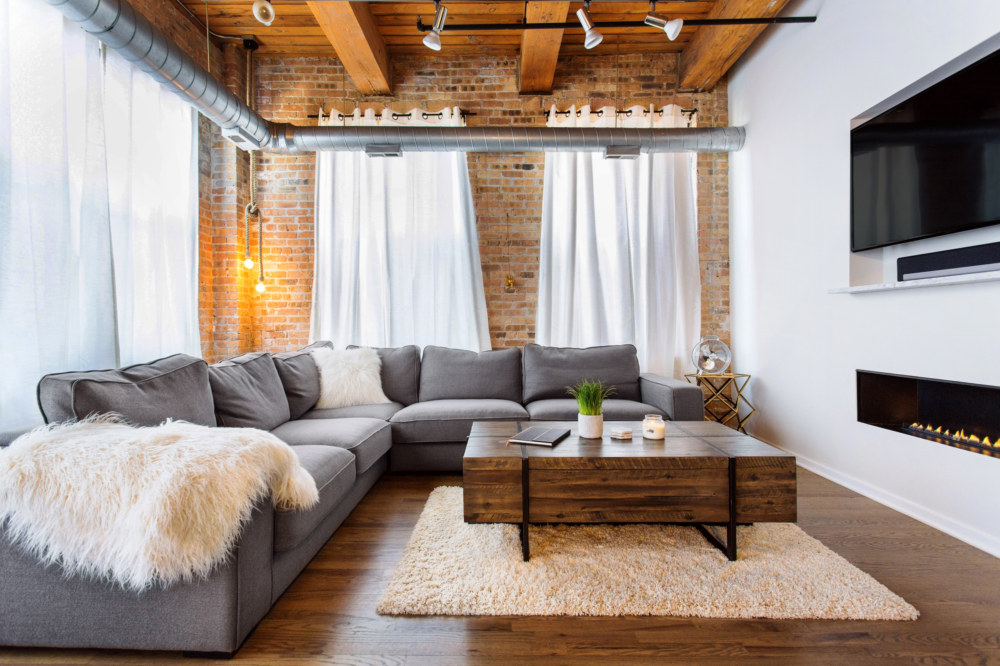

In [2]:
# Download and display example image and save it as demo.jpeg
!wget https://raw.githubusercontent.com/mrdbourke/airbnb-amenity-detection/master/custom_images/airbnb-article-cover.jpeg -O demo.jpeg
img = cv2.imread("./demo.jpeg")
cv2_imshow(img)

In [3]:
# Target classes with spaces removed
target_classes = ['Bathtub','Bed','Ceiling fan','Couch','Dishwasher','Gas stove','Kitchen & dining room table','Microwave oven','Mirror','Oven','Pillow','Refrigerator','Shower','Sink','Sofa bed','Stairs','Television','Toilet','Towel','Washing machine']

In [4]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(img)

model_final_f10217.pkl: 178MB [00:28, 6.35MB/s]                           


In [5]:
# look at the outputs. See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for specification
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)

tensor([57, 58, 73, 74, 57, 75, 16, 68, 60], device='cuda:0')
Boxes(tensor([[   0.0000, 1453.9869, 1655.3975, 2613.0017],
        [2286.4622, 1505.3202, 2435.3677, 1756.2062],
        [2027.8102, 1700.0392, 2283.4585, 1791.9384],
        [2774.0151, 1350.4049, 2922.1091, 1497.2405],
        [  15.0988, 1364.7780, 2958.0933, 2182.3225],
        [2309.0310, 1641.8070, 2413.0569, 1758.9819],
        [  15.2254, 1677.5558, 1296.6389, 2359.9910],
        [3392.2546,  157.2807, 3996.9722, 1039.7153],
        [1847.0930, 1639.1848, 3173.2312, 2267.0369]], device='cuda:0'))


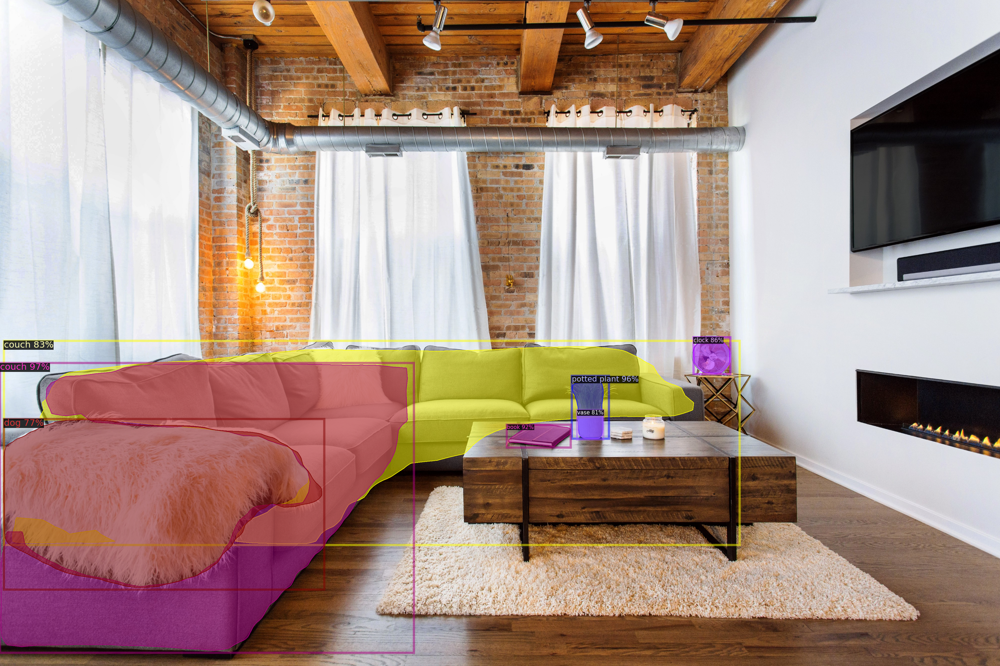

In [7]:
# We can use `Visualizer` to draw the predictions on the image.
num_amenities = 7

v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=0.7)
out = v.draw_instance_predictions(outputs["instances"][:num_amenities].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [9]:
# Download the trained model
!wget https://storage.googleapis.com/airbnb-amenity-detection-storage/airbnb-amenity-detection/open-images-data/retinanet_model_final/retinanet_model_final.pth 

# Download the train model config (instructions on how the model was built)
!wget https://storage.googleapis.com/airbnb-amenity-detection-storage/airbnb-amenity-detection/open-images-data/retinanet_model_final/retinanet_model_final_config.yaml

--2021-03-21 12:35:11--  https://storage.googleapis.com/airbnb-amenity-detection-storage/airbnb-amenity-detection/open-images-data/retinanet_model_final/retinanet_model_final.pth
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.206.128, 64.233.166.128, 74.125.133.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.206.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 446656531 (426M) [application/octet-stream]
Saving to: ‘retinanet_model_final.pth’

retinanet_model_fin 100%[===================>] 425.96M  92.8MB/s    in 4.8s    

2021-03-21 12:35:16 (89.2 MB/s) - ‘retinanet_model_final.pth’ saved [446656531/446656531]

--2021-03-21 12:35:17--  https://storage.googleapis.com/airbnb-amenity-detection-storage/airbnb-amenity-detection/open-images-data/retinanet_model_final/retinanet_model_final_config.yaml
Resolving storage.googleapis.com (storage.googleapis.com)... 142.251.5.128, 74.125.206.128, 74.125.133.128, ...
Co

In [10]:
cfg = get_cfg() # setup a default config, see: https://detectron2.readthedocs.io/modules/config.html
cfg.merge_from_file("./retinanet_model_final_config.yaml") # merge the config YAML file (a set of instructions on how to build a model)
cfg.MODEL.WEIGHTS = "./retinanet_model_final.pth" # setup the model weights from the fully trained model

# Create a default Detectron2 predictor for making inference
predictor = DefaultPredictor(cfg)

# Make a prediction the example image from above
outputs = predictor(img)

In [11]:
# Number of predicted amenities to draw on the target image
num_amenities = 7

# Set up a visulaizer instance: https://detectron2.readthedocs.io/modules/utils.html#detectron2.utils.visualizer.Visualizer
visualizer = Visualizer(img_rgb=img[:, :, ::-1], # we have to reverse the color order otherwise we'll get blue images (BGR -> RGB)
                        metadata=MetadataCatalog.get(cfg.DATASETS.TEST[0]).set(thing_classes=target_classes), # we tell the visualizer what classes we're drawing (from the target classes)
                        scale=0.7)

# Draw the models predictions on the target image
visualizer = visualizer.draw_instance_predictions(outputs["instances"][:num_amenities].to("cpu"))

# Display the image
cv2_imshow(visualizer.get_image()[:, :, ::-1])

IndexError: ignored

In [12]:
# Training bounding boxes (1.11G)
!wget https://storage.googleapis.com/openimages/2018_04/train/train-annotations-bbox.csv

# Validating bounding boxes (23.94M)
!wget https://storage.googleapis.com/openimages/v5/validation-annotations-bbox.csv
    
# Testing bounding boxes (73.89M)
!wget https://storage.googleapis.com/openimages/v5/test-annotations-bbox.csv

# Class names of images (11.73K)
!wget https://storage.googleapis.com/openimages/v5/class-descriptions-boxable.csv

--2021-03-21 12:36:29--  https://storage.googleapis.com/openimages/2018_04/train/train-annotations-bbox.csv
Resolving storage.googleapis.com (storage.googleapis.com)... 64.233.167.128, 64.233.166.128, 74.125.133.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|64.233.167.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1194033454 (1.1G) [text/csv]
Saving to: ‘train-annotations-bbox.csv’

train-annotations-b 100%[===================>]   1.11G   107MB/s    in 14s     

2021-03-21 12:36:44 (79.7 MB/s) - ‘train-annotations-bbox.csv’ saved [1194033454/1194033454]

--2021-03-21 12:36:44--  https://storage.googleapis.com/openimages/v5/validation-annotations-bbox.csv
Resolving storage.googleapis.com (storage.googleapis.com)... 64.233.184.128, 74.125.133.128, 74.125.140.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|64.233.184.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 25105048 (24M) [t

In [15]:
# Get coffeemaker and fireplace training images from Open Images and unzip them
!wget https://storage.googleapis.com/airbnb-amenity-detection-storage/airbnb-amenity-detection/open-images-data/cmaker-fireplace-train.zip
!unzip -q cmaker-fireplace-train # q is for quiet (nothing gets printed out, the unzip happens in the background)

# Get coffeemaker and fireplace validation images from Open Images and unzip them
!wget https://storage.googleapis.com/airbnb-amenity-detection-storage/airbnb-amenity-detection/open-images-data/cmaker-fireplace-valid.zip
!unzip -q cmaker-fireplace-valid

# # If you wanted to download the above two datasets yourself, you could do so by uncommenting the lines below
# !git clone https://github.com/mrdbourke/airbnb-amenity-detection.git
# # Notice the lack of spaces between the class names
# !python3 airbnb-amenity-detection/downloadOI.py --classes 'Coffeemaker,Fireplace' --dataset train
# !python3 airbnb-amenity-detection/downloadOI.py --classes 'Coffeemaker,Fireplace' --dataset validation

--2021-03-21 12:39:23--  https://storage.googleapis.com/airbnb-amenity-detection-storage/airbnb-amenity-detection/open-images-data/cmaker-fireplace-train.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 108.177.15.128, 173.194.76.128, 64.233.167.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|108.177.15.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 247479981 (236M) [application/zip]
Saving to: ‘cmaker-fireplace-train.zip’

cmaker-fireplace-tr 100%[===================>] 236.01M  58.0MB/s    in 4.1s    

2021-03-21 12:39:27 (58.0 MB/s) - ‘cmaker-fireplace-train.zip’ saved [247479981/247479981]

--2021-03-21 12:39:30--  https://storage.googleapis.com/airbnb-amenity-detection-storage/airbnb-amenity-detection/open-images-data/cmaker-fireplace-valid.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.206.128, 64.233.184.128, 74.125.133.128, ...
Connecting to storage.googleapis.com (storage.googleapis.c

In [16]:
# Setup the paths for the training and validation data
train_path = "./cmaker-fireplace-train/"
valid_path = "./cmaker-fireplace-valid/"

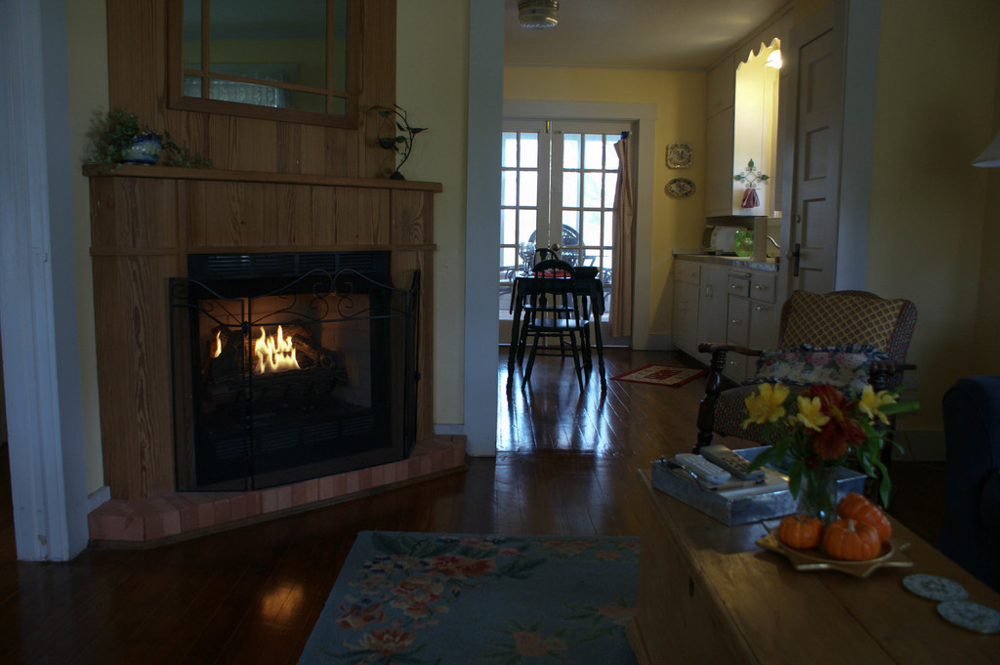

In [19]:
import os
# Read in a random image from the training directory
train_img = cv2.imread(train_path + random.sample(os.listdir("./cmaker-fireplace-train"), 2)[1])
cv2_imshow(train_img)